In [1]:
import os

In [2]:
import pandas as pd

In [3]:
import numpy as np

In [4]:
from sklearn.model_selection import train_test_split

In [5]:
from sklearn.metrics import accuracy_score

In [6]:
import matplotlib.pyplot as plt

In [7]:
%matplotlib inline

In [8]:
import plotly.express as px

In [9]:
from sklearn.ensemble import RandomForestClassifier as rfc, RandomForestRegressor as rfr

In [10]:
from sklearn.metrics import confusion_matrix, f1_score, mean_squared_error

In [11]:
import itertools
from math import sqrt

In [12]:
df=pd.read_csv('trainingData.csv')

In [13]:
df.head()

,WAP001,WAP002,WAP003,WAP004,WAP005,WAP006,WAP007,WAP008,WAP009,WAP010,...,WAP520,LONGITUDE,LATITUDE,OUTSIDE,BUILDINGID,SPACEID,RELATIVEPOSITION,USERID,PHONEID,TIMESTAMP
0,100,100,100,100,100,100,100,100,100,100,...,100,-7541.2643,4864920.778,2,1,106,2,2,23,1371713733
1,100,100,100,100,100,100,100,100,100,100,...,100,-7536.6212,4864934.225,2,1,106,2,2,23,1371713691
2,100,100,100,100,100,100,100,-97,100,100,...,100,-7519.1524,4864949.532,2,1,103,2,2,23,1371714095
3,100,100,100,100,100,100,100,100,100,100,...,100,-7524.5704,4864934.093,2,1,102,2,2,23,1371713807
4,100,100,100,100,100,100,100,100,100,100,...,100,-7632.1436,4864982.217,0,0,122,2,11,13,1369909710


In [14]:
df.describe().iloc[0].unique()

array([19937.])

In [15]:
df.describe()

,WAP001,WAP002,WAP003,WAP004,WAP005,WAP006,WAP007,WAP008,WAP009,WAP010,...,WAP520,LONGITUDE,LATITUDE,OUTSIDE,BUILDINGID,SPACEID,RELATIVEPOSITION,USERID,PHONEID,TIMESTAMP
count,19937.000000,19937.000000,19937.0,19937.0,19937.000000,19937.000000,19937.000000,19937.000000,19937.000000,19937.000000,...,19937.0,19937.000000,1.993700e+04,19937.000000,19937.000000,19937.000000,19937.000000,19937.000000,19937.000000,1.993700e+04
mean,99.823644,99.820936,100.0,100.0,99.613733,97.130461,94.733661,93.820234,94.693936,99.163766,...,100.0,-7464.275947,4.864871e+06,1.674575,1.212820,148.429954,1.833024,9.068014,13.021869,1.371421e+09
std,5.866842,5.798156,0.0,0.0,8.615657,22.931890,30.541335,33.010404,30.305084,12.634045,...,0.0,123.402010,6.693318e+01,1.223078,0.833139,58.342106,0.372964,4.988720,5.362410,5.572054e+05
min,-97.000000,-90.000000,100.0,100.0,-97.000000,-98.000000,-99.000000,-98.000000,-98.000000,-99.000000,...,100.0,-7691.338400,4.864746e+06,0.000000,0.000000,1.000000,1.000000,1.000000,1.000000,1.369909e+09
25%,100.000000,100.000000,100.0,100.0,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,...,100.0,-7594.737000,4.864821e+06,1.000000,0.000000,110.000000,2.000000,5.000000,8.000000,1.371056e+09
50%,100.000000,100.000000,100.0,100.0,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,...,100.0,-7423.060900,4.864852e+06,2.000000,1.000000,129.000000,2.000000,11.000000,13.000000,1.371716e+09
75%,100.000000,100.000000,100.0,100.0,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,...,100.0,-7359.193000,4.864930e+06,3.000000,2.000000,207.000000,2.000000,13.000000,14.000000,1.371721e+09
max,100.000000,100.000000,100.0,100.0,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,...,100.0,-7300.818990,4.865017e+06,4.000000,2.000000,254.000000,2.000000,18.000000,24.000000,1.371738e+09


In [16]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19937 entries, 0 to 19936
Columns: 529 entries, WAP001 to TIMESTAMP
dtypes: float64(2), int64(527)
memory usage: 80.5 MB


In [17]:
df.columns.values

array(['WAP001', 'WAP002', 'WAP003', 'WAP004', 'WAP005', 'WAP006',
       'WAP007', 'WAP008', 'WAP009', 'WAP010', 'WAP011', 'WAP012',
       'WAP013', 'WAP014', 'WAP015', 'WAP016', 'WAP017', 'WAP018',
       'WAP019', 'WAP020', 'WAP021', 'WAP022', 'WAP023', 'WAP024',
       'WAP025', 'WAP026', 'WAP027', 'WAP028', 'WAP029', 'WAP030',
       'WAP031', 'WAP032', 'WAP033', 'WAP034', 'WAP035', 'WAP036',
       'WAP037', 'WAP038', 'WAP039', 'WAP040', 'WAP041', 'WAP042',
       'WAP043', 'WAP044', 'WAP045', 'WAP046', 'WAP047', 'WAP048',
       'WAP049', 'WAP050', 'WAP051', 'WAP052', 'WAP053', 'WAP054',
       'WAP055', 'WAP056', 'WAP057', 'WAP058', 'WAP059', 'WAP060',
       'WAP061', 'WAP062', 'WAP063', 'WAP064', 'WAP065', 'WAP066',
       'WAP067', 'WAP068', 'WAP069', 'WAP070', 'WAP071', 'WAP072',
       'WAP073', 'WAP074', 'WAP075', 'WAP076', 'WAP077', 'WAP078',
       'WAP079', 'WAP080', 'WAP081', 'WAP082', 'WAP083', 'WAP084',
       'WAP085', 'WAP086', 'WAP087', 'WAP088', 'WAP089', 'WAP0

In [18]:
missing_values_count = df.isnull().sum()
missing_values_count

WAP001              0
WAP002              0
WAP003              0
WAP004              0
WAP005              0
                   ..
SPACEID             0
RELATIVEPOSITION    0
USERID              0
PHONEID             0
TIMESTAMP           0
Length: 529, dtype: int64

In [19]:
df["OUTSIDE"].unique()

array([2, 0, 3, 4, 1], dtype=int64)

In [20]:
df["BUILDINGID"].unique()

array([1, 0, 2], dtype=int64)

In [21]:
df["SPACEID"].unique()

array([106, 103, 102, 122, 105, 101, 112, 104, 110, 108, 109, 111, 107,
        15,  29, 117,  16,  28,  22,  10,   2,   4,   3,   5,   6,   9,
        27,   8,   7,  26,  18, 216,  17, 217, 247, 248, 246, 245, 244,
       243, 242, 241, 240, 201, 202, 204, 203, 205, 207, 206, 209, 211,
       208, 210, 212, 214, 213, 215, 121, 219, 221, 222, 218, 220, 250,
       223, 225, 224, 229, 226, 227, 228, 233, 231, 230, 232, 236, 235,
       234, 237, 238, 239, 141, 140, 143, 113, 114, 116, 115, 120, 118,
       128, 119, 129, 125, 124, 131, 127, 132, 126, 133, 134, 137, 135,
       136, 253, 254, 123, 130, 138, 139, 142, 146, 147, 249, 144,   1,
        30,  25,  13,  12,  11,  14], dtype=int64)

In [22]:
df["PHONEID"].unique()

array([23, 13, 16, 18,  3, 19,  6,  1, 14,  8, 24, 17,  7, 11, 22, 10],
      dtype=int64)

In [23]:
import plotly.offline as pyo

In [24]:
pyo.init_notebook_mode()

In [25]:
px.scatter(df, x="LONGITUDE", y="LATITUDE")

In [26]:
px.scatter(df, x="LONGITUDE", y="LATITUDE", color="USERID")

In [27]:
corr_matrix = df.corr()

In [28]:
px.imshow(corr_matrix)

In [29]:
px.histogram(df.iloc[:, 520:529],nbins=20)

In [30]:
def clean_data(df):
    df.iloc[:, 0:520] = np.where(df.iloc[:, 0:520] <= 0, 
                df.iloc[:, 0:520] + 105, 
                df.iloc[:, 0:520] - 100)
    
    columns_removed = ['USERID', 'PHONEID','TIMESTAMP']
    for col in columns_removed:
        df.drop(col, axis=1, inplace=True)
    return df

In [31]:
trainingData  = clean_data(df)

In [32]:
def preprocess_data(df):
    global X
    global y
    X = df.drop(['LONGITUDE', 'LATITUDE','OUTSIDE','BUILDINGID', 'SPACEID','RELATIVEPOSITION'], axis=1)
    y = df[['BUILDINGID', 'OUTSIDE']]
    y = pd.get_dummies(data=y, columns=['BUILDINGID', 'OUTSIDE'])
    return X, y

In [33]:
X, y = preprocess_data(trainingData)

In [34]:
def split_data(preprocess_data):
    global X_train
    global X_test
    global y_train
    global y_test
    
    X_train, X_test, y_train, y_test = train_test_split(X, 
                                                        y, 
                                                        test_size = 0.2, 
                                                        random_state = 42,
                                                        shuffle=True)

    print("Training set has {} samples.".format(X_train.shape[0]))
    print("Testing set has {} samples.".format(X_test.shape[0]))
    return X_train, X_test, y_train, y_test

In [35]:
X_train, X_test, y_train, y_test = split_data(preprocess_data)

Training set has 15949 samples.
Testing set has 3988 samples.


In [36]:
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA 
from scipy.sparse import lil_matrix

In [37]:
scaler = StandardScaler()

In [38]:
scaler.fit(X_train)

StandardScaler()

In [39]:
X_train = scaler.transform(X_train)
X_test = scaler.transform(X_test)

In [40]:
pca = PCA(.95)

In [41]:
pca.fit(X_train)

PCA(n_components=0.95)

In [42]:
X_train_pca = pca.transform(X_train)
X_test_pca = pca.transform(X_test)

In [43]:
print("Number of PCA Components = {}.".format(pca.n_components_))

Number of PCA Components = 258.


In [44]:
print("Total Variance Explained by PCA Components = {}.".format(pca.explained_variance_ratio_.sum()))

Total Variance Explained by PCA Components = 0.95018443957599.


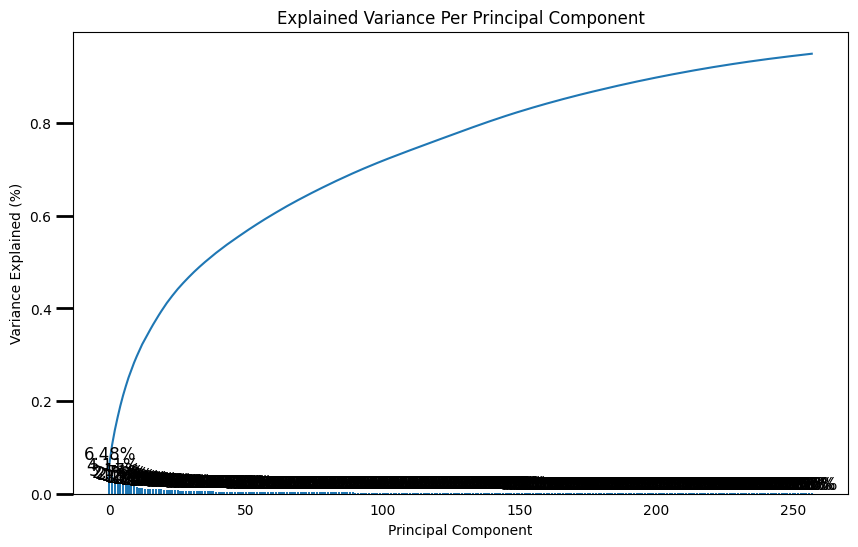

In [45]:
def pca_plot(pca):
    num_components = len(pca.explained_variance_ratio_)
    ind = np.arange(num_components)
    vals = pca.explained_variance_ratio_
 
    plt.figure(figsize=(10, 6))
    ax = plt.subplot(111)
    cumvals = np.cumsum(vals)
    ax.bar(ind, vals)
    ax.plot(ind, cumvals)
    for i in range(num_components):
        ax.annotate(r"%s%%" % ((str(vals[i]*100)[:4])), (ind[i]+0.2, vals[i]), va="bottom", ha="center", fontsize=12)
 
    ax.xaxis.set_tick_params(width=0)
    ax.yaxis.set_tick_params(width=2, length=12)
 
    ax.set_xlabel("Principal Component")
    ax.set_ylabel("Variance Explained (%)")
    plt.title('Explained Variance Per Principal Component')

pca_plot(pca)

In [46]:
X_train_pca = lil_matrix(X_train_pca).toarray()
y_train = lil_matrix(y_train).toarray()
X_test_pca = lil_matrix(X_test_pca).toarray()
y_test = lil_matrix(y_test).toarray()

In [50]:
from sklearn.ensemble import RandomForestClassifier

In [51]:
rf_clf = RandomForestClassifier()

In [52]:
rf_clf.fit(X_train_pca, y_train)

RandomForestClassifier()

In [53]:
predictions = rf_clf.predict(X_test_pca)

In [54]:
accuracy = accuracy_score(y_test,predictions)

In [55]:
type(accuracy)

numpy.float64

In [56]:
print("Accuracy = ",accuracy)

Accuracy =  0.9801905717151455


In [57]:
data = pd.read_csv('trainingData.csv')

In [58]:
data2 = data[:10]

In [59]:
[i for i in data2.columns.values if 'WAP' not in i]

['LONGITUDE',
 'LATITUDE',
 'OUTSIDE',
 'BUILDINGID',
 'SPACEID',
 'RELATIVEPOSITION',
 'USERID',
 'PHONEID',
 'TIMESTAMP']

In [60]:
data.replace(100, np.nan, inplace=True)
data[['OUTSIDE','BUILDINGID', 'SPACEID','RELATIVEPOSITION','USERID','PHONEID']] = \
data[['OUTSIDE','BUILDINGID', 'SPACEID','RELATIVEPOSITION','USERID','PHONEID']].astype(str)

In [61]:
x_columns = [i for i in data.columns.values if 'WAP' in i]
metadata_fields = [i for i in data.columns.values if 'WAP' not in i]

In [62]:
data[metadata_fields].describe(include=['object'])

,OUTSIDE,BUILDINGID,SPACEID,RELATIVEPOSITION,USERID,PHONEID
count,19937,19937,19937,19937,19937,19937
unique,5,3,123,2,18,16
top,3,2,202,2,11,14
freq,5048,9492,484,16608,4516,4835


In [63]:
print('data pre-drop ',data.shape)
data.dropna(how='all', axis=1, inplace=True)
data.dropna(how='all', axis=0, inplace=True)
print('data post-drop ', data.shape)
#Also update our list of input columns
x_columns = [i for i in data.columns.values if 'WAP' in i]

data pre-drop  (19937, 529)
data post-drop  (19937, 474)


In [64]:
from IPython.display import display

In [65]:
from sklearn.preprocessing import StandardScaler as ssc

In [66]:
from sklearn.decomposition import PCA

In [67]:
def plot_confusion_matrix(observed, predicted,
                          normalize=False,
                          title='Confusion matrix',
                          cmap=plt.cm.Blues):
    
    cm = confusion_matrix(observed, predicted)
    classes = list(observed.unique())
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')
        
    print('F1 Score: %s'%f1_score(list(observed), list(predicted), average='micro'))

    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(cm[i, j], fmt),
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    plt.tight_layout()
    plt.show()

In [68]:
class  DataPrep():
    def __init__(self):
        
        self.x_columns = []
        self.metadata_columns = []
        self.pca_columns = []
        self.scaler = ssc()
        self.pca = PCA()
        self.pre_pca_columns = []
        
    def fit(self,dat):
        
        data = dat.copy()
        data.loc[:,['OUTSIDE','BUILDINGID', 'SPACEID','RELATIVEPOSITION','USERID','PHONEID']] = \
        data[['OUTSIDE','BUILDINGID', 'SPACEID','RELATIVEPOSITION','USERID','PHONEID']].astype(str)
        
        x_columns_all = [i for i in data.columns.values if 'WAP' in i]
        data.loc[:,x_columns_all] = data.loc[:,x_columns_all].replace(100, np.nan)      

        data = data.dropna(how='all', axis=1)
        data = data.dropna(how='all', axis=0)
        
        self.pre_pca_columns = data.columns.values

        self.x_columns = [i for i in data.columns.values if 'WAP' in i]
        self.metadata_columns = [i for i in data.columns.values if 'WAP' not in i]
        
        data.loc[:,self.x_columns] = np.power(10,data[self.x_columns]/10)
        data.loc[:,self.x_columns] = data.loc[:,self.x_columns].fillna(0)
        self.scaler.fit(data[self.x_columns])
        data.loc[:,self.x_columns] = self.scaler.transform(data[self.x_columns])        
        self.pca.fit(data[self.x_columns])
        pca_data = pd.DataFrame(self.pca.transform(data[self.x_columns]))
        self.pca_columns = ['PCA_%s'%i for i in pca_data.columns.values]
        components = pd.DataFrame(data=[self.pca.n_components_, self.pca.explained_variance_ratio_], columns=['explained_variance'])
        components['cum_variance'] = components.explained_variance.cumsum()
        display(components)
        
    def transform(self,dat, dev=False):
        data = dat.copy()
            
        data[['OUTSIDE','BUILDINGID', 'SPACEID','RELATIVEPOSITION','USERID','PHONEID']] = \
        data[['OUTSIDE','BUILDINGID', 'SPACEID','RELATIVEPOSITION','USERID','PHONEID']].astype(str)
        data = data.loc[:,self.pre_pca_columns].copy()
        data.loc[:,self.x_columns] = data.loc[:,self.x_columns].replace(100, np.nan)
        data.loc[:,self.x_columns] = np.power(10,data[self.x_columns]/10)
        data.loc[:,self.x_columns] = data.loc[:,self.x_columns].fillna(0)
        data.loc[:,self.x_columns] = self.scaler.transform(data[self.x_columns]) 
        pca_data = pd.DataFrame(self.pca.transform(data[self.x_columns]))
        
        self.pca_columns = ['PCA_%s'%i for i in pca_data.columns.values]
        pca_data.columns=self.pca_columns
        
        if dev:
            data['PARTITION'] = np.random.randint(0,3, size=len(data))
        else:
            pass
        
        
        for i in pca_data.columns.values:
            data.loc[:,i] = list(pca_data[i])
        
        return data

class HiddenMarkovChainModel():
    def __init__(self):
        self.prep = DataPrep()
        self.building_model = None
        self.outside_models = {}
        self.location_models = {}


    def fit(self, data):
        modeling_data = self.prep.fit(data)
        modeling_data = self.prep.transform(data, dev=True)
        building_training = modeling_data[modeling_data.PARTITION == 0].copy()
        location_training = modeling_data[modeling_data.PARTITION == 1].copy()
        test = modeling_data[modeling_data.PARTITION == 2].copy()
        
        self.building_model = rfc(n_estimators = 200)
        
        self.building_model.fit(building_training[self.prep.pca_columns], building_training['BUILDINGID'])
        results = self.building_model.predict(test[self.prep.pca_columns])
        plot_confusion_matrix(test['BUILDINGID'], results, normalize=True)
      
        
        for i in modeling_data.BUILDINGID.unique():
            outsidedata = building_training[building_training.BUILDINGID == i]
            outsidetestdata = test[test.BUILDINGID == i]
            
            outside_model = rfc(n_estimators = 200)
            
            outside_model.fit(outsidedata[self.prep.pca_columns], outsidedata['OUTSIDE'])
            results = outside_model.predict(outsidetestdata[self.prep.pca_columns])
            print('Confusion Matrix for outside prediction, Building %s'%i)
            plot_confusion_matrix(outsidetestdata['OUTSIDE'], results, normalize=True)
            self.outside_models[str(i)] = outside_model

        for i in modeling_data.BUILDINGID.unique():
            locationdata = location_training[location_training.BUILDINGID == i]
            locationtestdata = test[test.BUILDINGID == i]
            
            from sklearn.neighbors import KNeighborsRegressor as knr
            location_model = knr(algorithm='auto', leaf_size=30,
                  metric_params=None, n_jobs=-1, n_neighbors=3, p=2,
                  weights='distance')
            
            location_model.fit(locationdata[self.prep.pca_columns], locationdata[['LONGITUDE', 'LATITUDE']])
            results = pd.DataFrame(location_model.predict(locationtestdata[self.prep.pca_columns]), 
                                columns=['LONGITUDE', 'LATITUDE'])
            print('Buidlding %s lon RMSE: %s'%(i, sqrt(mean_squared_error(locationtestdata['LONGITUDE'], 
                                                                          results['LONGITUDE']))))
            print('Buidlding %s lat RMSE: %s'%(i, sqrt(mean_squared_error(locationtestdata['LATITUDE'], 
                                                                          results['LATITUDE']))))
            ax1 = locationtestdata.plot(kind='scatter', x='LONGITUDE', y='LATITUDE', color='r')    
            ax2 = results.plot(kind='scatter', x='LONGITUDE', y='LATITUDE', color='g', ax=ax1, title='building # %s'%i)
            
            self.location_models[str(i)] = location_model
        
    def predict(self, data):
        data = data.copy()
        data = self.prep.transform(data)

        building_prediction = self.building_model.predict(data[self.prep.pca_columns])
        data.loc[:,'BUILDINGID_PRED'] = building_prediction
        ids = data.BUILDINGID_PRED.unique()
        
        for bldg_id in data.BUILDINGID_PRED.unique():
            bldg_data = data[data.BUILDINGID_PRED == bldg_id]
            
            data.loc[data.BUILDINGID_PRED == bldg_id,'OUTSIDE_PRED'] = self.outside_models[str(bldg_id)].predict(bldg_data[self.prep.pca_columns])
            location = self.location_models[str(bldg_id)].predict(bldg_data[self.prep.pca_columns]) 
            data.loc[data.BUILDINGID_PRED == bldg_id, 'LON_PRED'] = [i[0] for i in location]
            data.loc[data.BUILDINGID_PRED == bldg_id, 'LAT_PRED'] = [i[1] for i in location]

        return data

In [69]:
from sklearn.model_selection import train_test_split

In [70]:
data_original = pd.read_csv('trainingData.csv')

In [71]:
train, test = train_test_split(data_original, test_size=0.15)

model = HiddenMarkovChainModel()


,explained_variance,cum_variance
0,461,461
1,"[0.02049033334591945, 0.019884639871018024, 0....","[461.02049033334595, 461.019884639871, 461.018..."


2024-04-17 17:17:30,632 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:17:30,636 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:17:30,640 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: Performance

2024-04-17 17:17:30,736 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:17:30,740 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:17:30,746 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: Performance

2024-04-17 17:17:30,834 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:17:30,839 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:17:30,844 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: Performance

2024-04-17 17:17:30,928 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:17:30,932 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:17:30,936 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: Performance

2024-04-17 17:17:31,010 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:17:31,014 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:17:31,018 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: Performance

2024-04-17 17:17:31,102 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:17:31,105 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:17:31,109 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: Performance

2024-04-17 17:17:31,180 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:17:31,184 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:17:31,187 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: Performance

2024-04-17 17:17:31,263 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:17:31,267 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:17:31,273 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: Performance

2024-04-17 17:17:31,351 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:17:31,355 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:17:31,359 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: Performance

2024-04-17 17:17:31,432 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:17:31,436 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:17:31,440 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: Performance

2024-04-17 17:17:31,523 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:17:31,527 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:17:31,532 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: Performance

2024-04-17 17:17:31,627 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:17:31,631 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:17:31,636 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: Performance

2024-04-17 17:17:31,713 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:17:31,719 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:17:31,724 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: Performance

2024-04-17 17:17:31,802 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:17:31,806 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:17:31,810 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: Performance

2024-04-17 17:17:31,888 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:17:31,892 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:17:31,896 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: Performance

2024-04-17 17:17:31,978 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:17:31,982 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:17:31,986 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: Performance

2024-04-17 17:17:32,063 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:17:32,067 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:17:32,070 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: Performance

2024-04-17 17:17:32,145 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:17:32,150 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:17:32,153 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: Performance

2024-04-17 17:17:32,230 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:17:32,234 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:17:32,237 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: Performance

Normalized confusion matrix
F1 Score: 0.9901857693655801


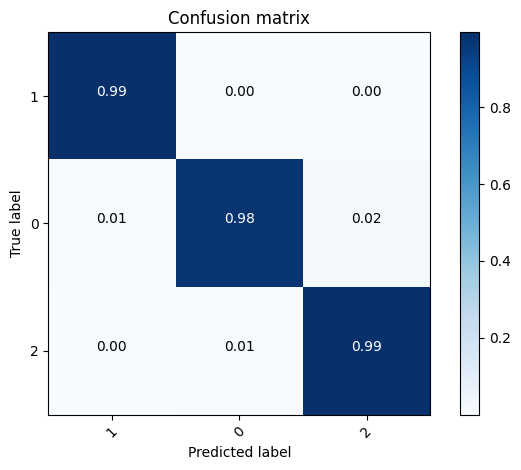

Confusion Matrix for outside prediction, Building 2
Normalized confusion matrix
F1 Score: 0.9009643916913946


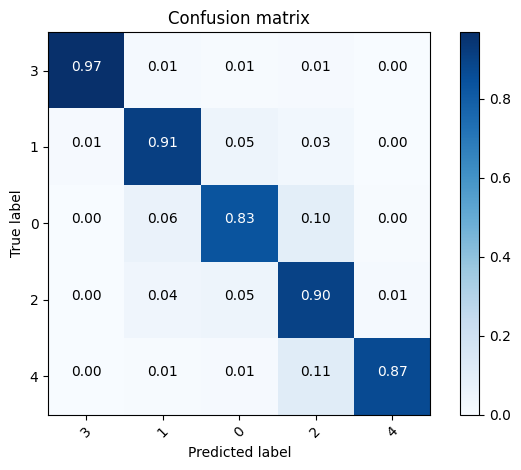

Confusion Matrix for outside prediction, Building 1
Normalized confusion matrix
F1 Score: 0.9605173587474473


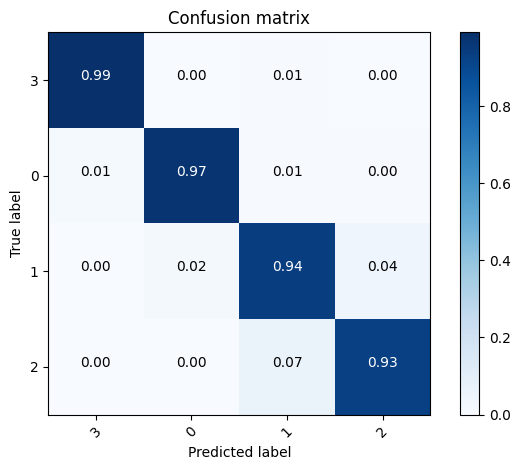

Confusion Matrix for outside prediction, Building 0
Normalized confusion matrix
F1 Score: 0.9188838416612589


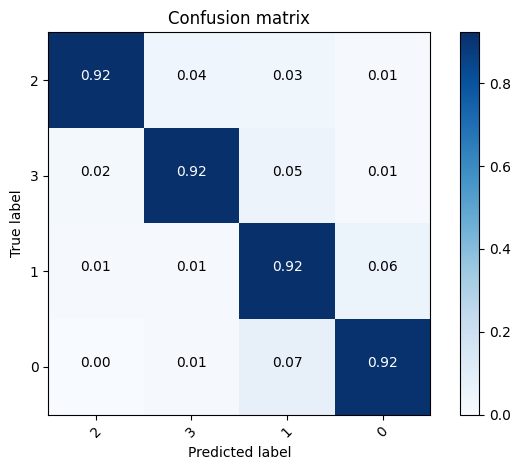

Buidlding 2 lon RMSE: 14.790860642697268
Buidlding 2 lat RMSE: 13.025179037755303
Buidlding 1 lon RMSE: 12.822865850143703
Buidlding 1 lat RMSE: 9.999145627331274
Buidlding 0 lon RMSE: 9.229282731743146
Buidlding 0 lat RMSE: 10.952929255522811


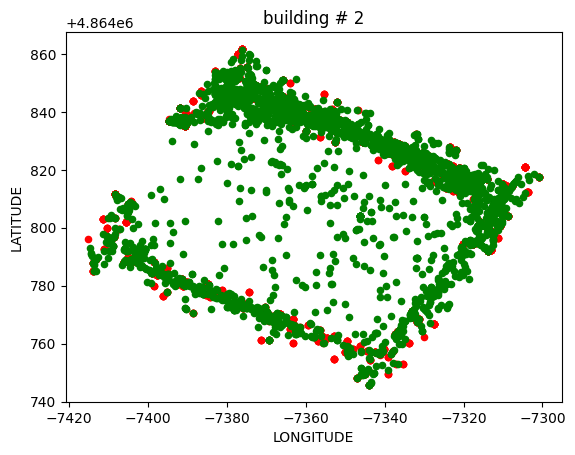

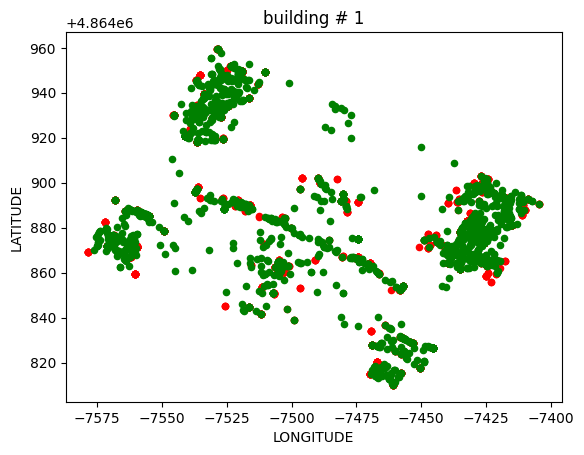

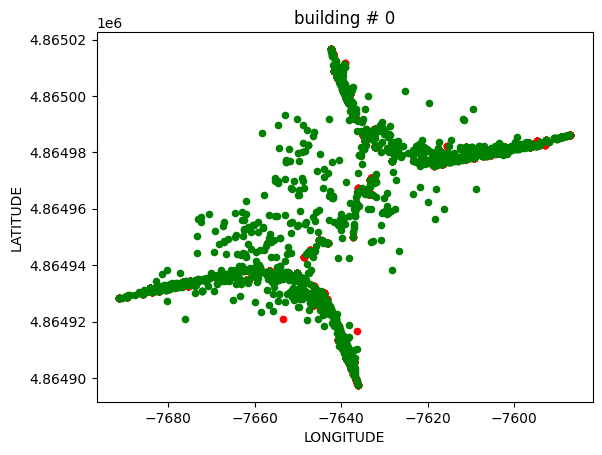

In [72]:
model.fit(train)

In [73]:
output = model.predict(test)

2024-04-17 17:18:18,550 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:18:18,553 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:18:18,555 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: Performance

2024-04-17 17:18:18,596 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:18:18,599 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:18:18,601 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: Performance

2024-04-17 17:18:18,637 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:18:18,639 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:18:18,641 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: Performance

2024-04-17 17:18:18,675 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:18:18,676 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:18:18,678 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: Performance

2024-04-17 17:18:18,713 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:18:18,715 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:18:18,716 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: Performance

2024-04-17 17:18:18,756 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:18:18,758 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:18:18,760 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: Performance

2024-04-17 17:18:18,798 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:18:18,800 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:18:18,802 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: Performance

2024-04-17 17:18:18,836 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:18:18,838 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:18:18,840 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: Performance

2024-04-17 17:18:18,872 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:18:18,874 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:18:18,875 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: Performance

2024-04-17 17:18:18,907 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:18:18,909 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:18:18,910 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: Performance

2024-04-17 17:18:18,942 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:18:18,944 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:18:18,946 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: Performance

2024-04-17 17:18:18,980 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:18:18,981 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:18:18,983 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: Performance

2024-04-17 17:18:19,017 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:18:19,019 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:18:19,021 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: Performance

2024-04-17 17:18:19,060 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:18:19,062 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:18:19,064 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: Performance

2024-04-17 17:18:19,099 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:18:19,101 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:18:19,103 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: Performance

2024-04-17 17:18:19,135 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:18:19,136 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:18:19,138 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: Performance

2024-04-17 17:18:19,176 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:18:19,178 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:18:19,181 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: Performance

2024-04-17 17:18:19,217 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:18:19,219 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:18:19,221 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: Performance

2024-04-17 17:18:19,251 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:18:19,253 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`


2024-04-17 17:18:19,255 [33772] WARNING  py.warnings:109: [JupyterRequire] C:\Users\kanna\AppData\Local\Temp\ipykernel_33772\2174292043.py:61: Performance

Longitude RMSE 19.33475744569405
Latitude RMSE 14.494866682106322


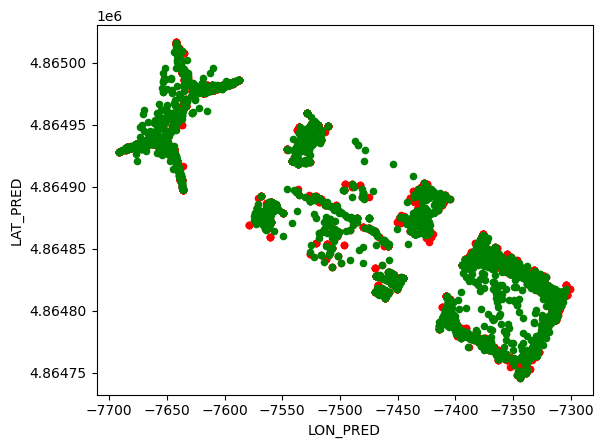

In [74]:
ax1 = output.plot(kind='scatter', x='LONGITUDE', y='LATITUDE', color='r')    
ax2 = output.plot(kind='scatter', x='LON_PRED', y='LAT_PRED', color='g', ax=ax1)

print('Longitude RMSE', sqrt(mean_squared_error(output['LONGITUDE'], output['LON_PRED'])))
print('Latitude RMSE', sqrt(mean_squared_error(output['LATITUDE'], output['LAT_PRED'])))

Normalized confusion matrix
F1 Score: 0.9923102641257104


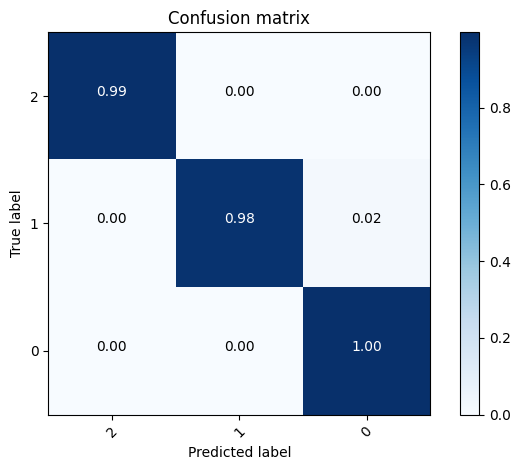

In [75]:
plot_confusion_matrix(output.BUILDINGID, output.BUILDINGID_PRED, normalize=True)